# Computer Vision - P4


## Delivery

Your overall grading will be penalized if the following requirements are not fulfilled:

- Implemented code should be commented exhaustively and in *English*.

- The questions introduced in the exercises must be answered.

- Add title to the figures to explain what is displayed.

- Answers to questions also need to be in *English*.

- Make sure to print and plot exactly what it is indicated. If a reference image is provided, your output is expected to be exactly the same unless instructed differently.

- The deliverable of both parts must be a file named **P4_Student1_Student2.zip** that includes:
    - The notebook P4_Student1_Student2.ipynb completed with the solutions to the exercises and their corresponding comments.
    - All the images used in this notebook (upload the ones that were not provided)
    
- It is required that your code can be run by us without need of any modification and without getting any errors.

- Use packages and solutions that were covered in your class and tutorials. If you are unsure about using a particular package, you should seek clarification from your instructor to confirm whether it is allowed.

- Please refrain from utilizing resources like ChatGPT to complete this lab assignment.


**Deadline (Campus Virtual): November 28th, 23:00 h**

In [131]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as FuncAnimation
from skimage import io, img_as_float, exposure
from skimage.util import img_as_float
from skimage.color import rgb2gray, rgba2rgb
from skimage.transform import resize, rotate, rescale, AffineTransform, warp
from skimage.feature import match_template, hog, ORB, SIFT, CENSURE, plot_matches, match_descriptors
from collections import defaultdict

%matplotlib inline

==============================================================================================
## Descriptors extraction for object detection, based on template matching, ORB, and HOG
==============================================================================================

The main topics of Laboratory 4 are:

    4.1) SSD and Normalized Cross-correlation for template matching

    4.2) HOG image descriptor for object (person) detection

    4.3) Recognition by correspondance, based on feature extraction (ORB)

In order to complete this practicum, the following concepts need to be understood: template matching, feature localization (Harris, Censure), feature descriptor (HOG,ORB, Sift) methods.

It is highly recommendable to structure the code in functions in order to reuse code for different tests and images and make it shorter and more readable. Specially the visualization commands should be encapsulated in separate functions.

## 1 Template matching

**1.1 (10 points)** Given the image 'einstein.png' and the template image 'eye.png', detect the location of the template in the image comparing the use of:
- SSD distance (hint: norm() in numpy.linalg).
- normalized cross-correlation (hint: match_template() of skimage.feature).

Don't forget to normalize the images (having pixel values between [0,1]) before comparing them.

In [106]:
def ssd(image, template):
    # Get the dimensions of the input image
    h, w = image.shape

    # Get the dimensions of the template
    t_height, t_width = template.shape

    # Initialize an array to store the SSD results
    result = np.zeros((h - t_height + 1, w - t_width + 1))

    # Iterate through the positions (m, n) in the input image
    for m in range(h - t_height + 1):
        for n in range(w - t_width + 1):
            # Extract the region of interest from the input image
            region = image[m:m+t_height, n:n+t_width]

            # Calculate the L2 (Euclidean) norm of the differences and store it in the result array
            result[m,n] = np.linalg.norm(template - region)

    # Return the array containing the SSD results
    return result

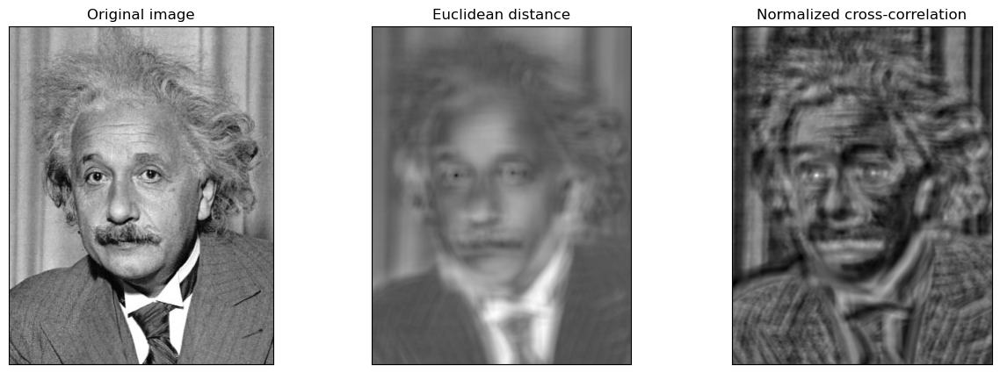

In [107]:
# Your solution here
einstein_im = io.imread("images/einstein.png")
eye_im = io.imread("images/eye.png")

# Convert to RGB, convert to grayscale and normalize images
einstein_normalized_im = img_as_float(rgb2gray(rgba2rgb(einstein_im)))
eye_normalized_im = img_as_float(rgb2gray(rgba2rgb(eye_im)))

# SSD distance
ssd_distance = ssd(einstein_normalized_im, eye_normalized_im)

# Normalized cross-correlation
cross_correlation = match_template(einstein_normalized_im, eye_normalized_im)

# Create subplots for Original, SSD distance and Normalized cross-correlation images
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

axs[0].imshow(einstein_normalized_im, cmap="gray")
axs[0].set_title("Original image")
axs[0].set_xticks([])
axs[0].set_yticks([])

axs[1].imshow(ssd_distance, cmap="gray")
axs[1].set_title("Euclidean distance")
axs[1].set_xticks([])
axs[1].set_yticks([])

axs[2].imshow(cross_correlation, cmap="gray")
axs[2].set_title("Normalized cross-correlation")
axs[2].set_xticks([])
axs[2].set_yticks([])

plt.show()

Create a **function** for template matching applying SSD distance and normalized cross-correlation and display the results in the following format:

<img src="images/tm.png" width="800" height="400">

**Use titles in all figures to understand what is being displayed.**

Note: the decision of threshold for SSD distance and normalized cross-correlation will affect your results, try values that get you as close to the shown result as possible but we understand you might not get exactly the same outcome.

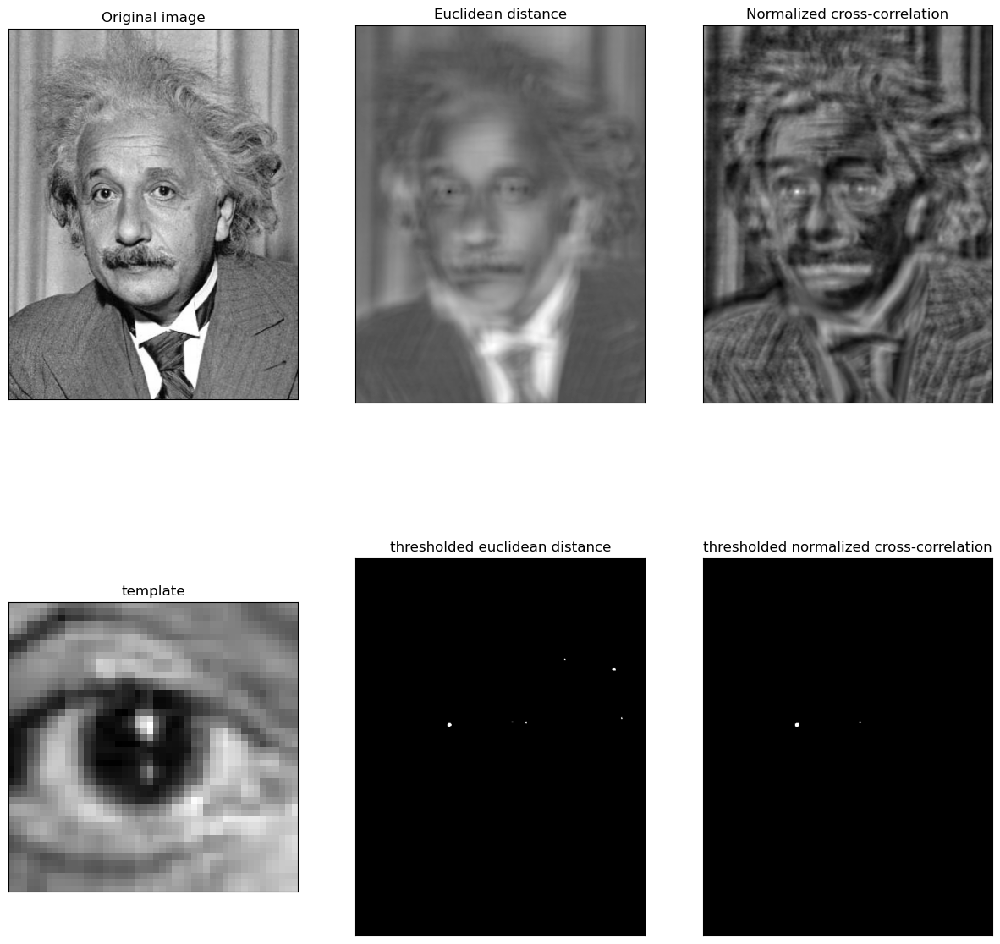

In [108]:
# Your solution here
def template_matching(image, template, ssd_threshold, cross_corr_threshold):
    # Normalize images and convert to grayscale
    if len(image.shape) > 2:
        if image.shape[2] == 4:
            # Convert to RGB, convert to grayscale and normalize images
            image = img_as_float(rgb2gray(rgba2rgb(image)))
        else:
            # Convert to grayscale and normalize images
            image = img_as_float(rgb2gray(image))
    else:
        # Normalize images
        image = img_as_float(image)

    if len(template.shape) > 2:
        if template.shape[2] == 4:
            # Convert to RGB, convert to grayscale and normalize images
            template = img_as_float(rgb2gray(rgba2rgb(template)))
        else:
            # Convert to grayscale and normalize images
            template = img_as_float(rgb2gray(template))
    else:
        # Normalize images
        template = img_as_float(template)

    # SSD distance
    ssd_distance = ssd(image, template)

    # Normalized cross-correlation
    cross_correlation = match_template(image, template)

    # Apply threshold
    ssd_distance_threshold = ssd_distance < ssd_threshold
    cross_correlation_threshold = cross_correlation > cross_corr_threshold

    # Create subplots for Original, SSD distance and Normalized cross-correlation images
    fig, axs = plt.subplots(2, 3, figsize=(15, 15))

    axs[0][0].imshow(einstein_im, cmap="gray")
    axs[0][0].set_title("Original image")
    axs[0][0].set_xticks([])
    axs[0][0].set_yticks([])

    axs[0][1].imshow(ssd_distance, cmap="gray")
    axs[0][1].set_title("Euclidean distance")
    axs[0][1].set_xticks([])
    axs[0][1].set_yticks([])

    axs[0][2].imshow(cross_correlation, cmap="gray")
    axs[0][2].set_title("Normalized cross-correlation")
    axs[0][2].set_xticks([])
    axs[0][2].set_yticks([])

    axs[1][0].imshow(template, cmap="gray")
    axs[1][0].set_title("template")
    axs[1][0].set_xticks([])
    axs[1][0].set_yticks([])

    axs[1][1].imshow(ssd_distance_threshold, cmap="gray")
    axs[1][1].set_title("thresholded euclidean distance")
    axs[1][1].set_xticks([])
    axs[1][1].set_yticks([])

    axs[1][2].imshow(cross_correlation_threshold, cmap="gray")
    axs[1][2].set_title("thresholded normalized cross-correlation")
    axs[1][2].set_xticks([])
    axs[1][2].set_yticks([])

    return ssd_distance, cross_correlation

_, _ = template_matching(einstein_im, eye_im, 8.6, 0.55)

**1.2 (5 points)** How does the result of the template matching change if the image changes its contrast (for example if you make it clearer or darker)?

Similarly to the previous case, please, visualize the euclidean distance and normalized cross-correlation images as well as the binarized (thresholded) images in the two cases.

**Note:** Use titles of the figures to explain what is displayed.


Read `einstein_br.png` and display the results of the template matching techniques used on 1.1 on this image, using `eye.png` as template:

/Users/davidblandon/anaconda3/lib/python3.10/site-packages/imageio/plugins/pillow.py:297: UserWarning: Loading 16-bit (uint16) PNG as int32 due to limitations in pillow's PNG decoder. This will be fixed in a future version of pillow which will make this warning dissapear.
  warnings.warn(


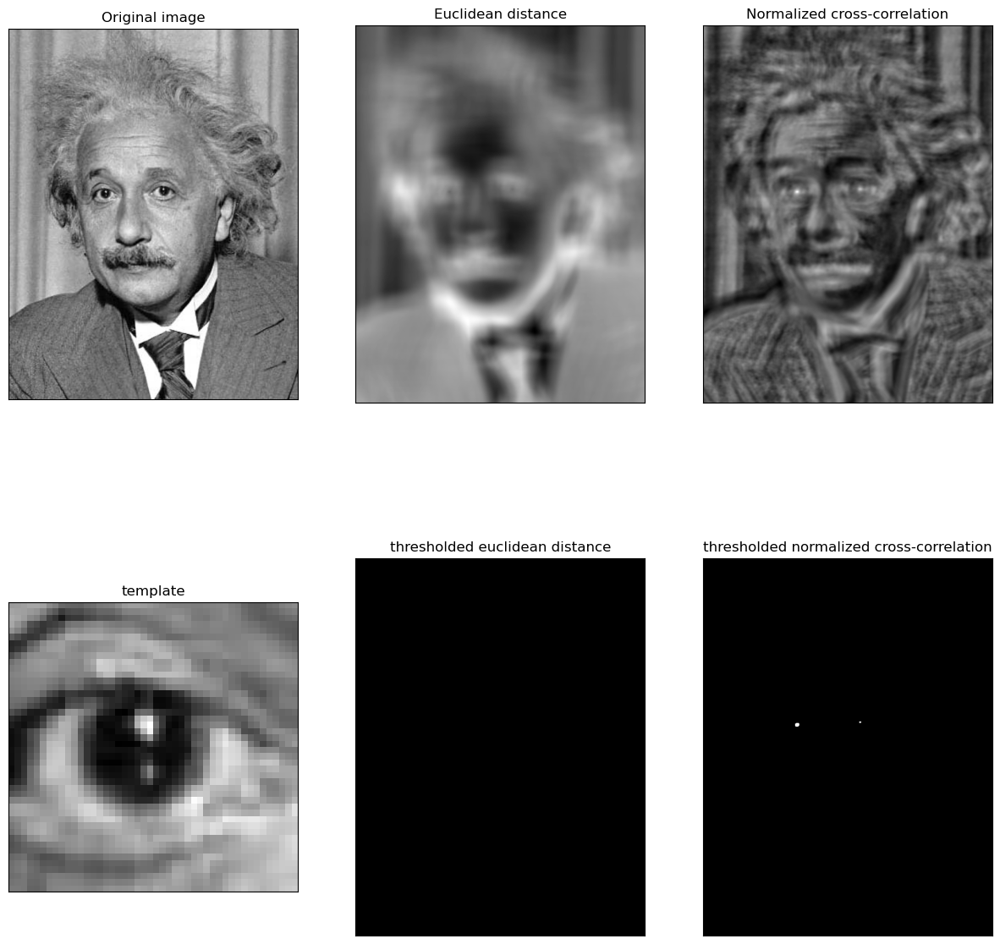

In [109]:
# Your solution here
einstein_br_im = io.imread("images/einstein_br.png")
einstein_br_ssd_im, einstein_br_ncc_im = template_matching(einstein_br_im, eye_im, 8.6, 0.55)

Print the minimum SSD and the maximum Normalized Cross-Correlation (NCC)

In [46]:
# Your solution here
print('minimum SSD: ', einstein_br_ssd_im.min(), '\nmaximum Normalized Cross-Correlation: ', einstein_br_ncc_im.max())

minimum SSD:  23.700079380083974 
maximum Normalized Cross-Correlation:  0.9768232838639446


**1.3 (5 points)** Read `einstein_mask.png` and display the results on this image using your previously coded function, using the `eye.png` template:

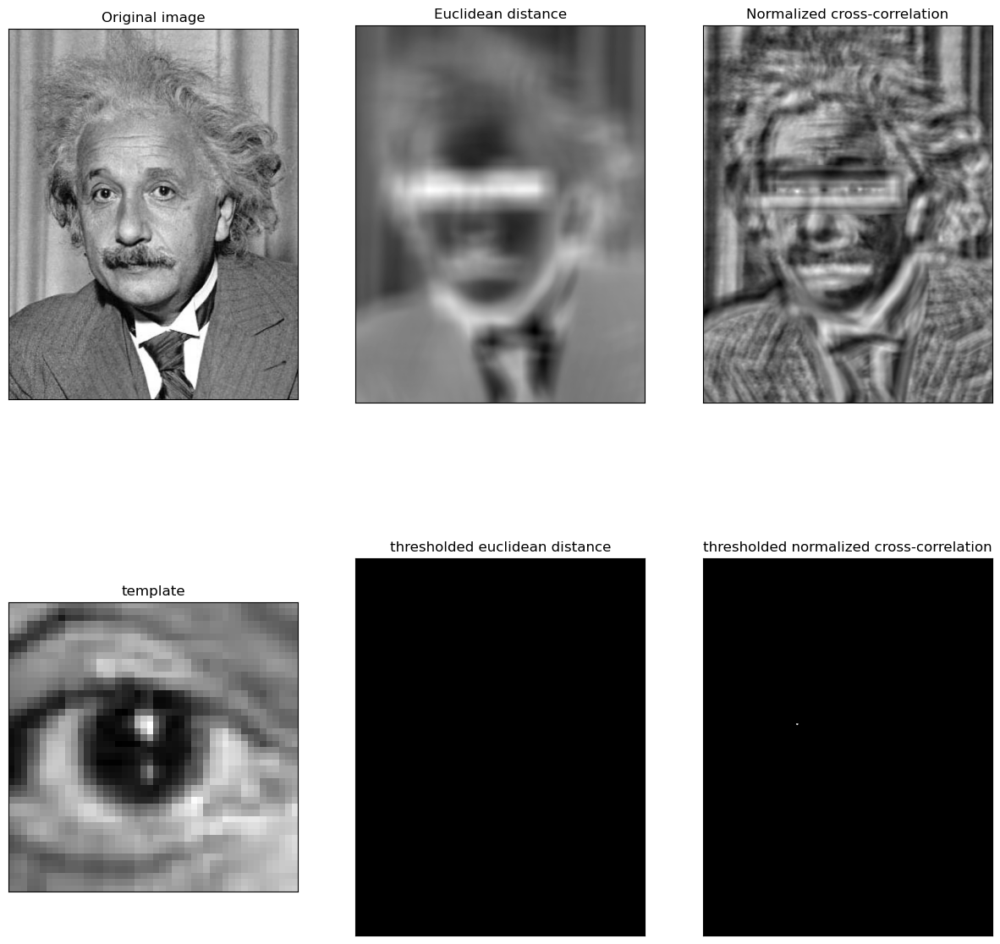

In [110]:
# Your solution here
einstein_mask_im = io.imread("images/einstein_mask.png")
einstein_mask_ssd_im, einstein_mask_ncc_im = template_matching(einstein_mask_im, eye_im, 8.6, 0.55)

Print the minimum SSD and the maximum NCC

In [111]:
# Your solution here
print('minimum SSD: ', einstein_mask_ssd_im.min(), '\nmaximum Normalized Cross-Correlation: ', einstein_mask_ncc_im.max())

minimum SSD:  23.70009485966591 
maximum Normalized Cross-Correlation:  0.6166362739336956


What are the distances between the template and the image around the eyes of the image?

In [112]:
# Your solution here
"""
SSD: Measures dissimilarity between the template and different regions in the image and lower values indicate better matches.
NCC: Measures similarity between the template and different regions in the image and higher values indicate better matches.
"""

'\nSSD: Measures dissimilarity between the template and different regions in the image and lower values indicate better matches.\nNCC: Measures similarity between the template and different regions in the image and higher values indicate better matches.\n'

Comment the template matching process:
* Is the algorithms affected by contrast changes in the image?
* How do metrics (i.e. minimum euclidean distance and maximum NCC) change in all previous cases? Is there a big difference among these values?
* What parameters it has and which measure for image comparisons works better.

In [113]:
# Your solution here
"""
- Is the algorithms affected by contrast changes in the image?
The SSD is affected by changes in contrast because it directly compares pixel intensities. If the overall contrast of the image changes, it will influence the SSD values.
Normalized Cross-Correlation (NCC) is less affected by changes in contrast because it normalizes the pixel values, making it more robust to overall intensity variations.

- How do metrics (i.e. minimum euclidean distance and maximum NCC) change in all previous cases?
Minimum SSD: A lower value indicates a better match. More sensitive to changes in pixel values and contrast.
Maximum NCC: A higher value indicates a better match. More robust to changes in overall image intensity.
- Is there a big difference among these values?
Yes, there is a big difference among these values especially in minimum euclidean distance (SSD).

- What parameters it has and which measure for image comparisons works better.
SSD: No specific parameters other than the template and input image. Thresholds may be used to determine matches based on the resulting similarity values.
NCC: No specific parameters for the basic approach. Thresholds may be used to determine matches based on the resulting similarity values.
NCC is generally more robust to changes in contrast and illumination, making it suitable for certain scenarios.
SSD is fast, but sensitive
"""

'\n- Is the algorithms affected by contrast changes in the image?\nThe SSD is affected by changes in contrast because it directly compares pixel intensities. If the overall contrast of the image changes, it will influence the SSD values.\nNormalized Cross-Correlation (NCC) is less affected by changes in contrast because it normalizes the pixel values, making it more robust to overall intensity variations.\n\n- How do metrics (i.e. minimum euclidean distance and maximum NCC) change in all previous cases?\nMinimum SSD: A lower value indicates a better match. More sensitive to changes in pixel values and contrast.\nMaximum NCC: A higher value indicates a better match. More robust to changes in overall image intensity.\n- Is there a big difference among these values?\nYes, there is a big difference among these values especially in minimum euclidean distance (SSD).\n\n- What parameters it has and which measure for image comparisons works better.\nSSD: No specific parameters other than the t

**1.4 (5 points)** How does the result of the template matching change if instead the template is the one that changes its contrast (for example if you make it clearer or darker)? To this purpose, use the `eye_br.png` template.

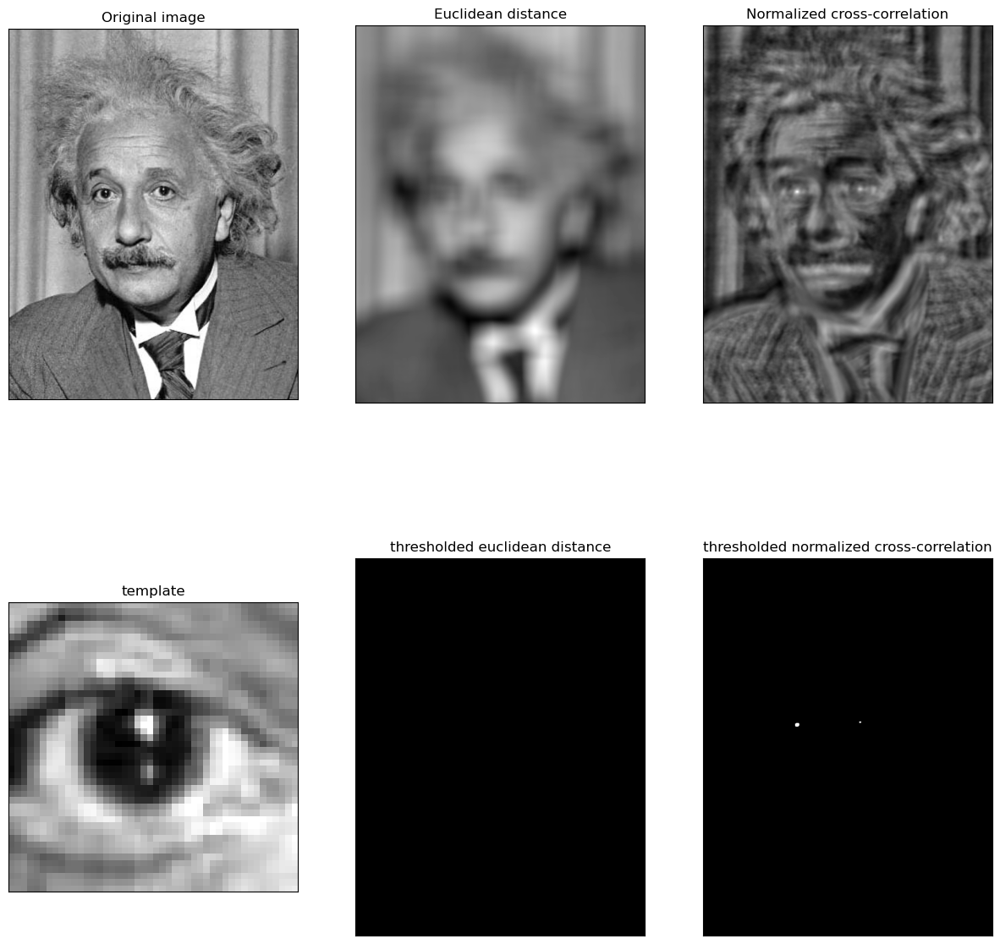

In [114]:
# Your solution here
eye_br_im = io.imread("images/eye_br.png")
_, _ = template_matching(einstein_im, eye_br_im, 8.6, 0.55)

Check how the result changes if the template is rotated.

Visualize the template and its rotation by 2º, 5º, 10º, 15º and 20º. Obtain again the template matching using the Euclidean distance and normalized cross-correlation. Pick fixed values of thresholds that are well suited for the non rotated image.  

**Help:** use the function rotate() in skimage.transform

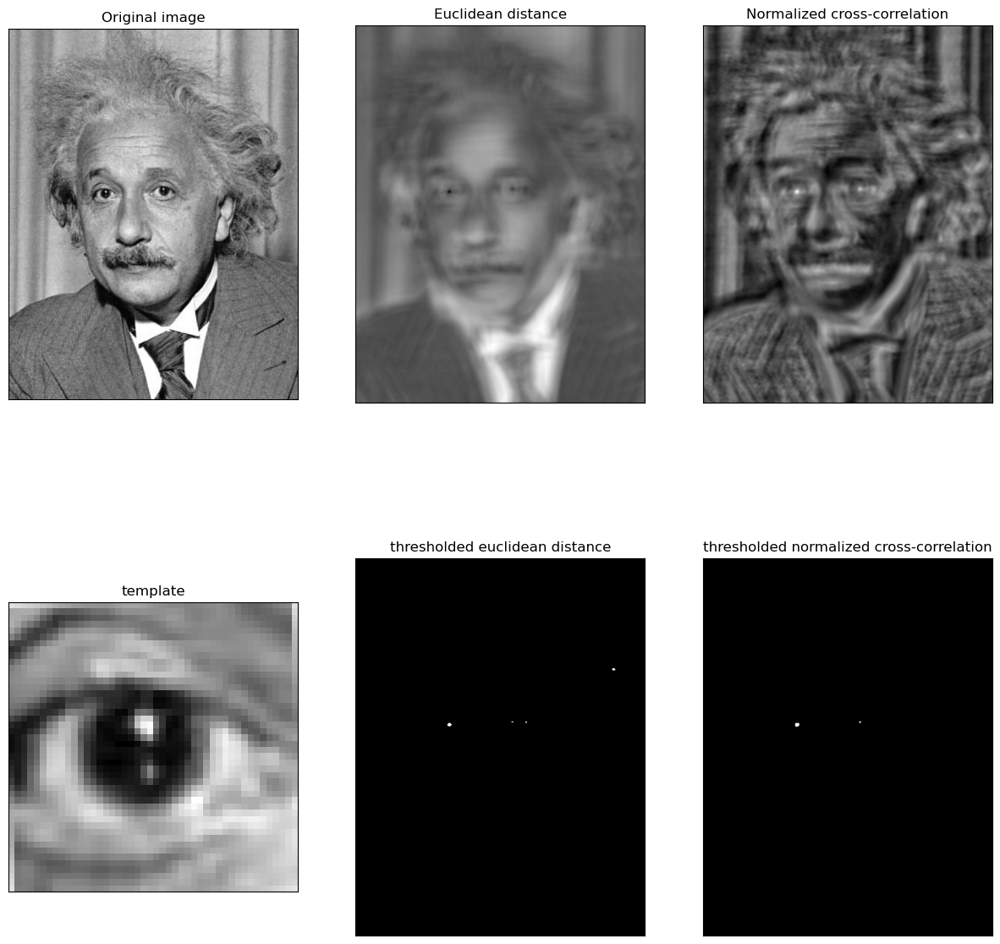

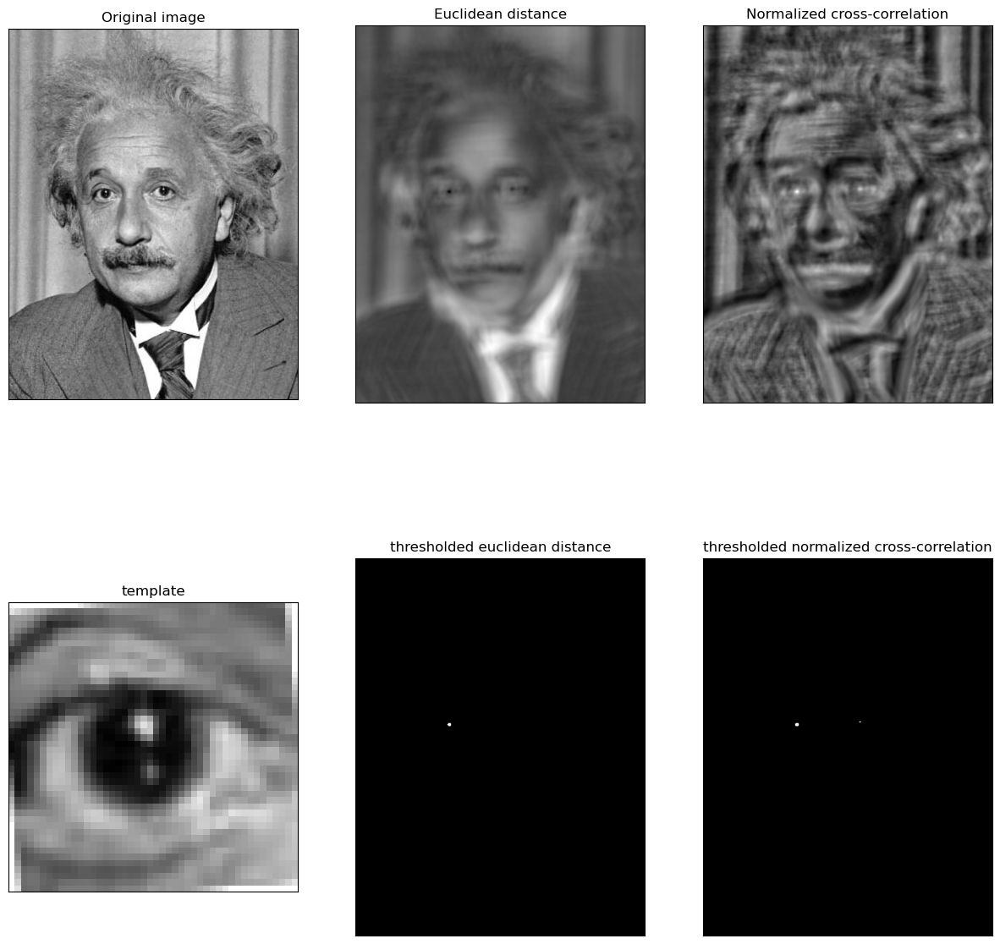

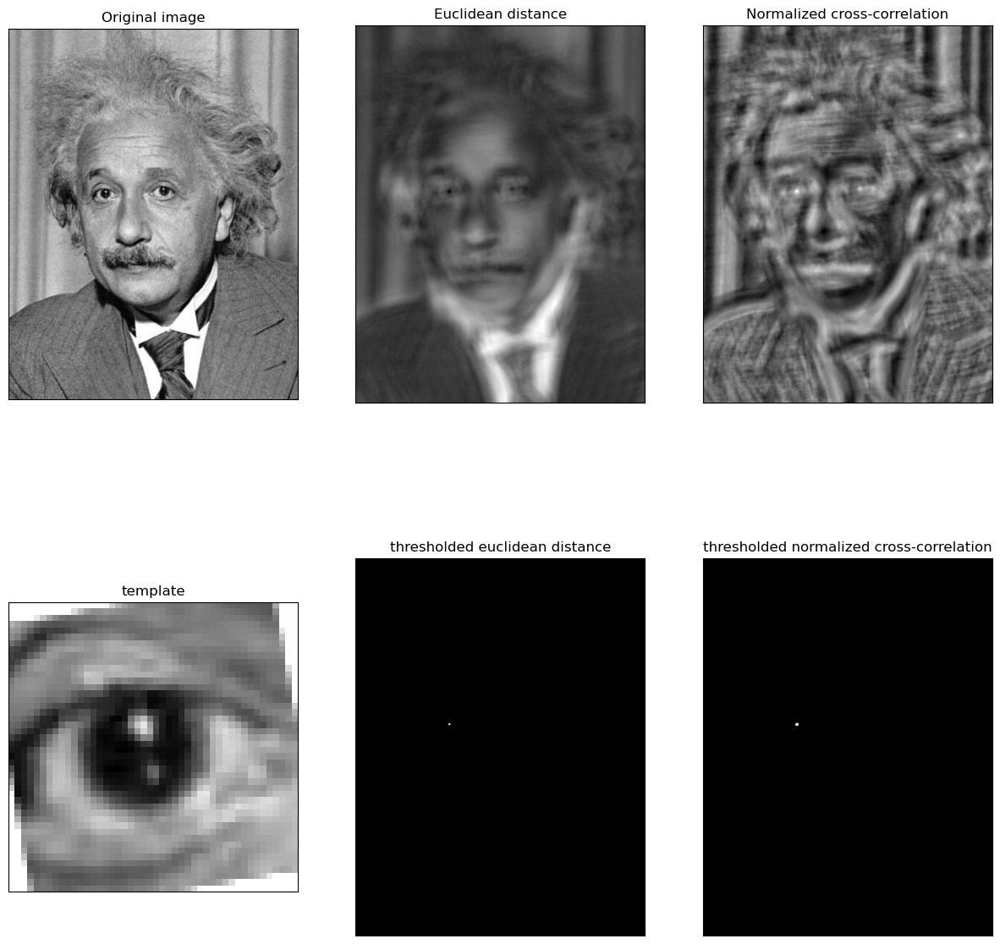

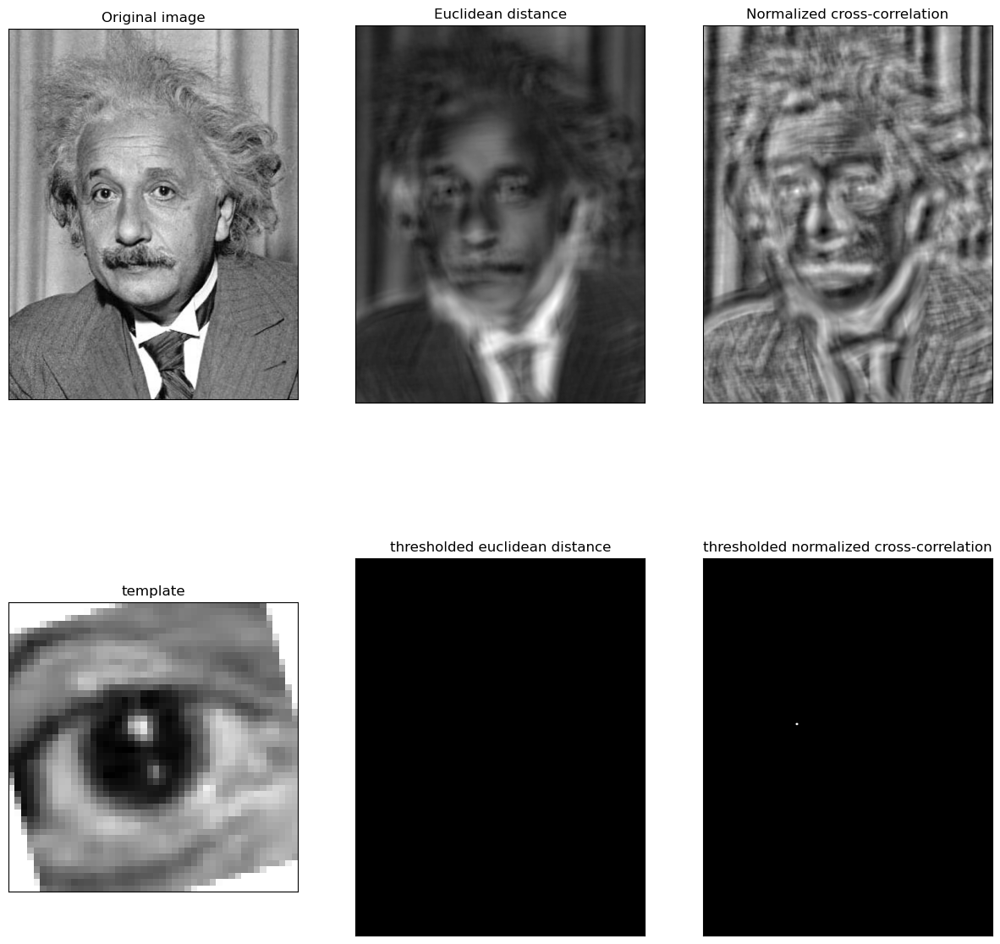

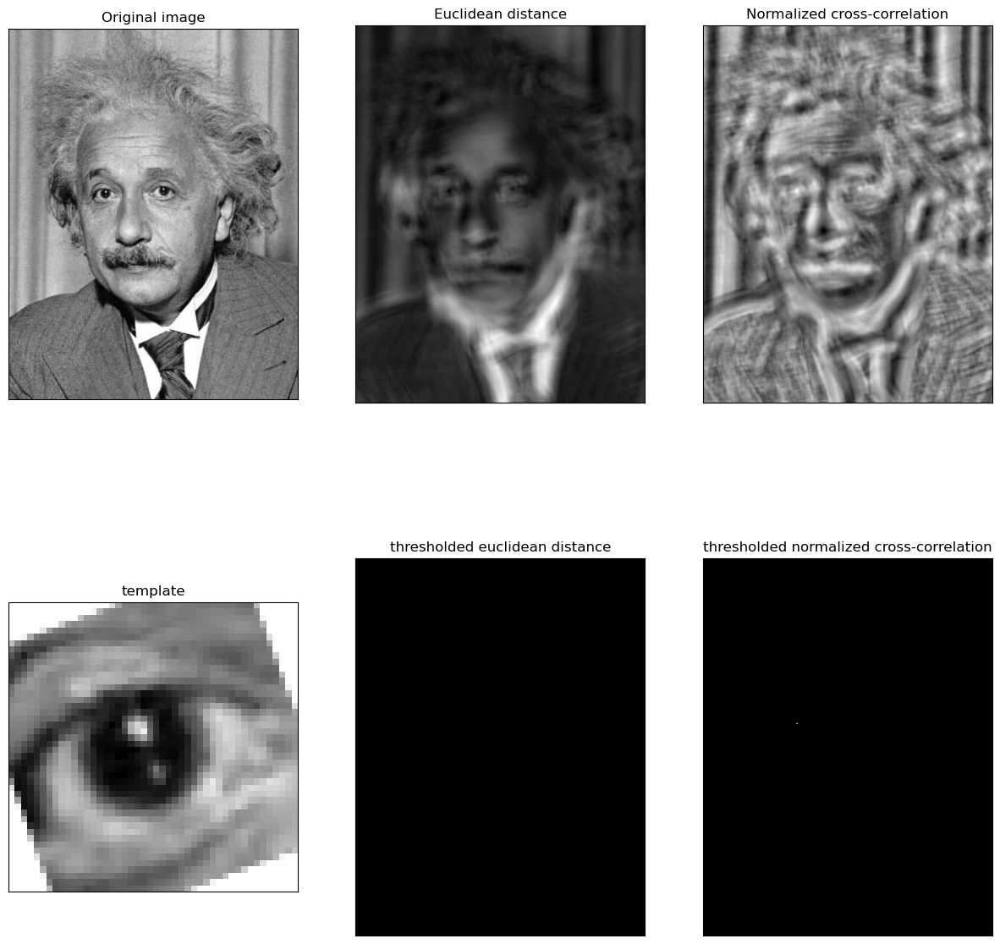

In [115]:
# Your solution here
einstein_mask_ssd_im, einstein_mask_ncc_im = template_matching(einstein_im, rotate(eye_im, 2), 8.35, 0.55)
einstein_mask_ssd_im, einstein_mask_ncc_im = template_matching(einstein_im, rotate(eye_im, 5), 8.6, 0.55)
einstein_mask_ssd_im, einstein_mask_ncc_im = template_matching(einstein_im, rotate(eye_im, 10), 8.6, 0.55)
einstein_mask_ssd_im, einstein_mask_ncc_im = template_matching(einstein_im, rotate(eye_im, 15), 8.6, 0.55)
einstein_mask_ssd_im, einstein_mask_ncc_im = template_matching(einstein_im, rotate(eye_im, 20), 8.6, 0.55)

Comment the template matching process:
* Please, explain briefly the algorithm, including advantages and disadvantage
* Is the algorithms affected by contrast changes in the tempate image?
* What parameters it has and which measure for image comparisons works better.

In [116]:
# Your solution here
"""
- Please, explain briefly the algorithm, including advantages and disadvantage
    - Advantages:
        - SSD is precise in detecting subtle pixel-wise differences.
        - NCC is robust to changes in overall contrast and illumination.
    - Disadvantages:
        - SSD can be sensitive to changes in contrast and lighting conditions.
        - NCC might struggle with precise pixel-wise matching.

- Is the algorithms affected by contrast changes in the tempate image?
SSD: Affected by contrast changes because it directly compares pixel intensities, making it sensitive to variations in lighting conditions.
NCC: Less affected by contrast changes due to normalization, providing more robustness to overall intensity variations.

- What parameters it has and which measure for image comparisons works better.
SSD: No specific parameters other than the template and input image. Thresholds may be used to determine matches based on the resulting similarity values.
NCC: No specific parameters for the basic approach. Thresholds may be used to determine matches based on the resulting similarity values.
"""

'\n- Please, explain briefly the algorithm, including advantages and disadvantage\n    - Advantages:\n        - SSD is precise in detecting subtle pixel-wise differences.\n        - NCC is robust to changes in overall contrast and illumination.\n    - Disadvantages:\n        - SSD can be sensitive to changes in contrast and lighting conditions.\n        - NCC might struggle with precise pixel-wise matching.\n\n- Is the algorithms affected by contrast changes in the tempate image?\nSSD: Affected by contrast changes because it directly compares pixel intensities, making it sensitive to variations in lighting conditions.\nNCC: Less affected by contrast changes due to normalization, providing more robustness to overall intensity variations.\n\n- What parameters it has and which measure for image comparisons works better.\nSSD: No specific parameters other than the template and input image. Thresholds may be used to determine matches based on the resulting similarity values.\nNCC: No specif

# 2 Histogram of Oriented Gradients

In this section we will treat the following topic: HOG image descriptor. Application to person detection.

The Histogram of Oriented Gradients (HOG) feature descriptor is classical image descriptor for object detection.

Given the image `person_template.bmp` and the folder `/images/TestPersonImages/`, apply the HOG descriptor in order to detect where there is a person in the images. To this purpose, apply the "sliding window" technique. We use images from GRAZ 01 data from [INRIA datasets](http://pascal.inrialpes.fr/data/human/).

**2.1. (5 points)** Read the template (`person_template.bmp`), obtain its HOG descriptor (with the optimal parameters) and visualize it.

Help: the HOG detector function is in the skimage.feature library ([Help](http://scikit-image.org/docs/dev/auto_examples/features_detection/plot_hog.html#sphx-glr-auto-examples-features-detection-plot-hog-py)).

Obtain 2 versions of the HOG descriptor:
- With the default parameters.
- Then with 4x4 pixels per cell and 2x2 cells per block and orientations set to 8

Visualize the original image, the default values HOG descriptor and the defined parameters HOG descriptor in a 1x3 grid of images.

In [117]:
""" orientations = 3
pixels_per_cell = (8, 8)
cells_per_block = (5, 5) """ # Best parameters

orientations = 9
pixels_per_cell = (8, 8)
cells_per_block = (3, 3)

Text(0.5, 1.0, 'Hog with params')

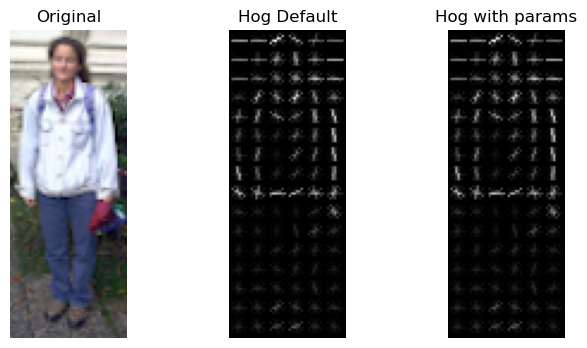

In [118]:
template = io.imread("images/person_template.bmp")
template = rgba2rgb(template)
template_gray = rgb2gray(template)

template_fd, template_default = hog(
   template_gray,  visualize=True)
template_params_fd, template_params = hog(template_gray, orientations = orientations,
                                              pixels_per_cell = pixels_per_cell,
                                              cells_per_block = cells_per_block, visualize=True)


fig, (ax1, ax2, ax3) = plt.subplots(
    1, 3, figsize=(8, 4))

ax1.axis('off')
ax1.imshow(template, cmap=plt.cm.gray)
ax1.set_title('Original')

ax2.axis('off')
ax2.imshow(template_default, cmap=plt.cm.gray)
ax2.set_title('Hog Default')

ax3.axis('off')
ax3.imshow(template_params, cmap=plt.cm.gray)
ax3.set_title('Hog with params')

Print and explain the number of feature resulting on the default parameters HOG descriptor (4536). Break this number down, starting from the original image size.

In [119]:
# Features vector elements breakdown

M, N, _ = template.shape

default_cells_per_block = (3, 3)
default_pixels_per_cell = (8, 8)
default_orientations = 9

# Compute number of cells
m, n = default_pixels_per_cell
num_cells = ((M // m) - 1) * ((N // n) - 1)

# Compute number of blocks
p, q = default_cells_per_block
num_blocks = ((M // m - p + 1) * (N // n - q + 1))

# Compute total elements
total_elements = num_blocks * p * q * default_orientations

print('Number of features: ', template_fd.shape[0])
print('Original image shape: ', template.shape)
print("Number of cells: ", num_cells)
print("Number of blocks: ", num_blocks)
print("Total elements in HOG feature vector: ", total_elements)


Number of features:  4536
Original image shape:  (129, 49, 3)
Number of cells:  75
Number of blocks:  56
Total elements in HOG feature vector:  4536


**2.2. (15 points)** Apply the HOG descriptor on the complete set of images for person detection.

a) Read images from the folder "TestPersonImages", slide a window on each image, obtain the HOG descriptor and compare to the HOG descriptor of the person template.

b) Visualize the location in the image that is the most similar to the person template using the distance between the template and test image descriptors.

Display the results of every person detection following this format:

<img src="images/hog.png" width="400" height="200">

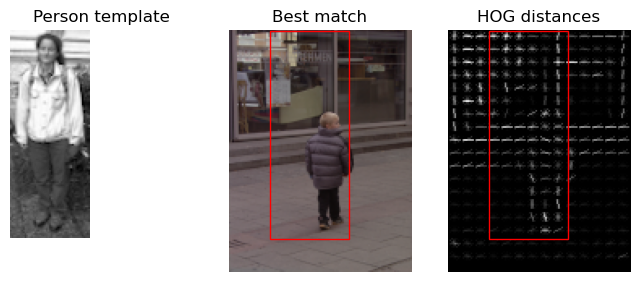

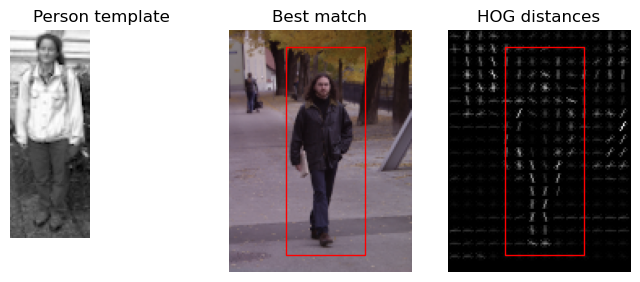

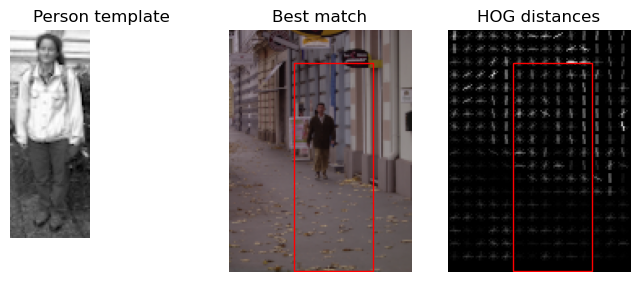

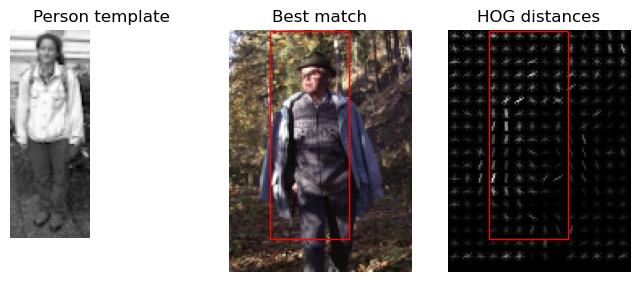

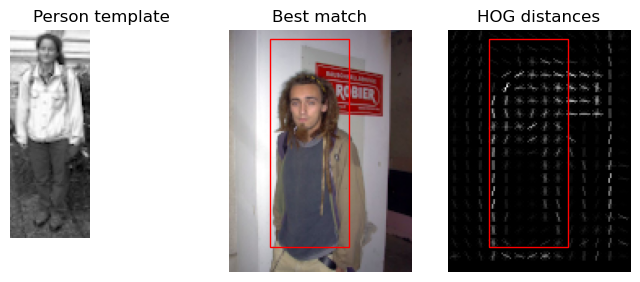

...

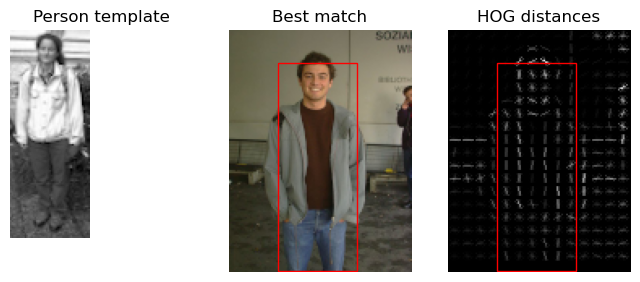

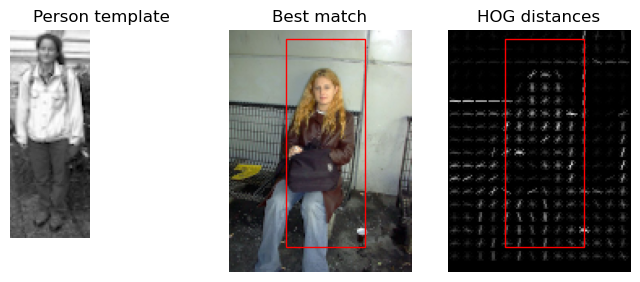

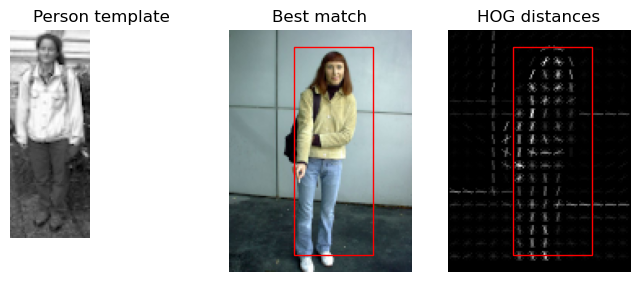

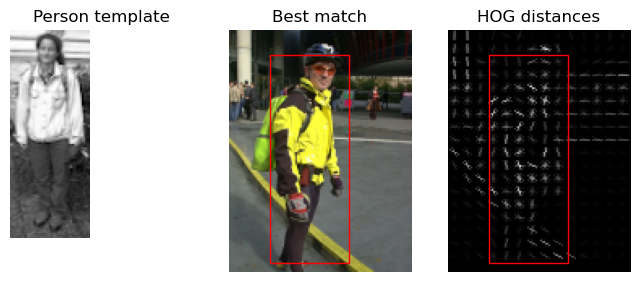

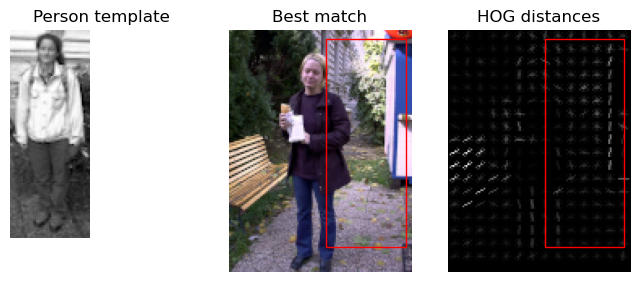

In [120]:
ic = io.ImageCollection('images/TestPersonImages/*.bmp')

for image in ic:
    image_gray = rgb2gray(image)
    _, test_hog = hog(image_gray, orientations = orientations, cells_per_block = cells_per_block, pixels_per_cell = pixels_per_cell,  visualize=True)
    min_distance = float('inf')
    best_match = None
    step_size = 5
    # Sliding window technique
    for i in range(0, image_gray.shape[0] - template.shape[0], step_size):
        for j in range(0, image_gray.shape[1] - template.shape[1], step_size):
            window = image_gray[i:i+template.shape[0], j:j+template.shape[1]]
            window_fd = hog(window, orientations=orientations, cells_per_block=cells_per_block, pixels_per_cell=pixels_per_cell )
            distance = np.linalg.norm(template_params_fd - window_fd)
            if distance < min_distance:
                min_distance = distance
                best_match = (j, i)

    fig, (ax1, ax2, ax3) = plt.subplots(
        1, 3, figsize=(8, 4), sharex=True, sharey=True)
    ax1.axis('off')
    ax1.imshow(template_gray, cmap=plt.cm.gray)
    ax1.set_title('Person template')

    ax2.axis('off')
    ax2.imshow(image, cmap=plt.cm.gray)
    ax2.add_patch(plt.Rectangle(
        best_match,  template.shape[1], template.shape[0], edgecolor='r', facecolor='none', linewidth=1))
    ax2.set_title('Best match')

    ax3.axis('off')
    ax3.imshow(test_hog, cmap=plt.cm.gray)
    ax3.add_patch(plt.Rectangle(
        best_match, template.shape[1], template.shape[0], edgecolor='r', facecolor='none', linewidth=1))
    ax3.set_title('HOG distances')

Count on how many images were the persons detected correctly and discuss the failures.
What do you think can be the reasons for the failures?

In [121]:
"""
By using the default parameters (9 orientations, 8x8 pixels per cell, 3x3 cells per block), there are 3 failures of 15 images. By using the parameters (3 orientations, 8x8 pixels per cell, 5x5 cells per block), there are 2 failures of 15 images.
2 of the 3 failures can be explained by the fact that the background of the images is more complex than the background of the template image. The third failure can be explained by the fact that the person in the image is not a full body person, but a half body person.
"""

'\nBy using the default parameters (9 orientations, 8x8 pixels per cell, 3x3 cells per block), there are 3 failures of 15 images. By using the parameters (3 orientations, 8x8 pixels per cell, 5x5 cells per block), there are 2 failures of 15 images.\n2 of the 3 failures can be explained by the fact that the background of the images is more complex than the background of the template image. The third failure can be explained by the fact that the person in the image is not a full body person, but a half body person.\n'

Test several values of the parameters (``orientations``, ``pixels_per_cell``, ``cells_per_block``) to show which are the optimal values for the person detection problem. Note: since you are testing several values and not the whole universe, this question might have different solutions, make sure to try several to at least be directionally correct

In [122]:
"""
We tried several combinations of parameters, here's a summary of the results:
- 8 orientations, 4x4 pixels per cell, 5x5 cells per block: 5 failures of 15 images
- 6 orientations, 2x2 pixels per cell, 6x6 cells per block: 4 failures of 15 images
- 3 orientations, 4x4 pixels per cell, 4x4 cells per block: 4 failures of 15 images
- 12 orientations, 8x8 pixels per cell, 2x2 cells per block: 3 failures of 15 images
- 2 orientations, 4x4 pixels per cell, 8x8 cells per block: 7 failures of 15 images
- 3 orientations, 8x8 pixels per cell, 5x5 cells per block: 2 failures of 15 images

The best combination of parameters is 3 orientations, 8x8 pixels per cell, 5x5 cells per block, with 2 failures of 15 images.
And maybe this combination has only 1 failure because im taking as second failure an image that has the window slightly shifted to the right, but it is still a good match.

"""

"\nWe tried several combinations of parameters, here's a summary of the results:\n- 8 orientations, 4x4 pixels per cell, 5x5 cells per block: 5 failures of 15 images\n- 6 orientations, 2x2 pixels per cell, 6x6 cells per block: 4 failures of 15 images\n- 3 orientations, 4x4 pixels per cell, 4x4 cells per block: 4 failures of 15 images\n- 12 orientations, 8x8 pixels per cell, 2x2 cells per block: 3 failures of 15 images\n- 2 orientations, 4x4 pixels per cell, 8x8 cells per block: 7 failures of 15 images\n- 3 orientations, 8x8 pixels per cell, 5x5 cells per block: 2 failures of 15 images\n\nThe best combination of parameters is 3 orientations, 8x8 pixels per cell, 5x5 cells per block, with 2 failures of 15 images.\nAnd maybe this combination has only 1 failure because im taking as second failure an image that has the window slightly shifted to the right, but it is still a good match.\n\n"

Comment the object detection process:
* Please, explain briefly the algorithm, including advantages and disadvantage
* Do you see any advantages of the HOG-based object detector compared to the template-based object detection? (The answer should be up to 10-15 lines).

In [123]:
"""
Q1:

The HOG algorithm is based on the idea that local object appearance and shape within an image can be described by the distribution of intensity gradients or edge directions.
The image is divided into small connected regions called cells, and for the pixels within each cell, a histogram of gradient directions is compiled.
The descriptor vectors can be used as features for classification tasks, such as whether a section of an image contains a certain object of interest or not.
Basically it has 5 steps (Taken from scikit-image documentation):
1. Global image normalization (optional): This aims to reduce the influence of illumination effects.
2. Computing the gradient image in x and y: This aims to capture edge, contour and texture information.
3. Computing gradient histograms: This aims to encode the dominant gradient directions in each cell.
4. Normalizing across blocks: This aims to further suppress the effect of illumination across the image.
5. Flattening into a feature vector: This aims to provide a feature vector representation that is insensitive to the specific position within the image.

Benefits:
- Robust to changes in illumination and contrast.
- Robust to geometric and photometric distortions.
- Efficient to compute.

Drawbacks:
- Not invariant to scale and rotation
- Not robust to changes in viewpoint.
- Noise sensitive.
"""

"""
Q2:

Yes, there are advantages of HOG over template matching. Hog is robust to variations in illumination and contrast, this is because captures the local
gradient in comparison to template matching that relies only on pixel intensities.
Also, HOG's use of local descriptors and block normalization provides a degree of translation invariance, allowing for the detection of objects
even when they are slightly displaced withing the image.
In terms of performance, HOG is more computationally efficient than template matching, which can be very slow for large templates and images.
This is because HOG extracts features from the image and then compares them to the template, while template matching compares the template to every
possible region in the image.
Another advantage of HOG is that it is more robust to noise than template matching, because it uses local descriptors and block normalization.
Template matching is more sensitive to noise because it relies on pixel intensities.
Finally, HOG uses less memory than template matching.
"""

"\nQ2:\n\nYes, there are advantages of HOG over template matching. Hog is robust to variations in illumination and contrast, this is because captures the local\ngradient in comparison to template matching that relies only on pixel intensities.\nAlso, HOG's use of local descriptors and block normalization provides a degree of translation invariance, allowing for the detection of objects\neven when they are slightly displaced withing the image.\nIn terms of performance, HOG is more computationally efficient than template matching, which can be very slow for large templates and images.\nThis is because HOG extracts features from the image and then compares them to the template, while template matching compares the template to every\npossible region in the image.\nAnother advantage of HOG is that it is more robust to noise than template matching, because it uses local descriptors and block normalization.\nTemplate matching is more sensitive to noise because it relies on pixel intensities.\

# 3 ORB feature detector and binary descriptor

Let us consider the problem of feature extraction that contains two subproblems:
- feature location,
- image feature description.

Let us focus on ORB, an approximation of SIFT method, and analyse if ORB is  scale and rotation invariant, a property that is very important for real-time applications.

**Hint:** `ORB` is a function within the module `skimage.feature`
                             
**Help**: We suggest to have a look at the [ORB example](http://scikit-image.org/docs/dev/auto_examples/features_detection/plot_orb.html) how to compute the ORB descriptors and find the descriptors match. You can use the function match_descriptors from `skimage.feature` module in order to compute and show the similar detected descriptors of the given images.

**3.1 (10 points)** First, detect the censure in the image `starbucks4.jpg`. Analyze and discuss the effect of different values of the parameters in censure function. (this is a separate funcion from ORB)

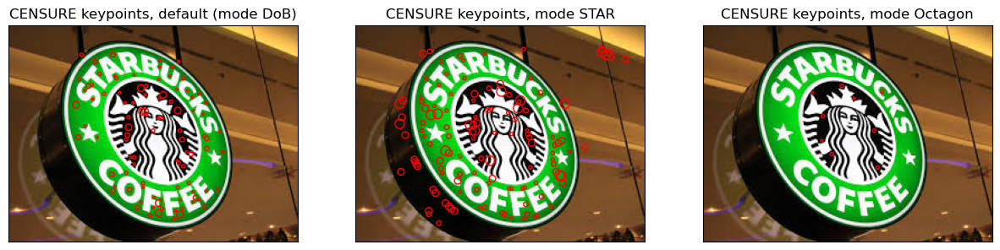

In [124]:
# Your solution here
starbucks4_im = io.imread("images/starbucks4.jpg")

# Convert to grayscale
starbucks4_gray_im = rgb2gray(starbucks4_im)

# Initialize the CENSURE detector default
detector = CENSURE()
# Initialize the CENSURE detector mode Octagon
detector2 = CENSURE(min_scale=1, max_scale=4, mode='Octagon', non_max_threshold=0.3, line_threshold=8)
# Initialize the CENSURE detector mode STAR
detector3 = CENSURE(min_scale=2, max_scale=7, mode='STAR', non_max_threshold=0.1, line_threshold=20)

# Detect keypoints
detector.detect(starbucks4_gray_im)
detector2.detect(starbucks4_gray_im)
detector3.detect(starbucks4_gray_im)

# Create subplots for CENSURE detectors
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

axs[0].imshow(starbucks4_im)
axs[0].set_title("CENSURE keypoints, default (mode DoB)")
axs[0].scatter(
    detector.keypoints[:, 1],
    detector.keypoints[:, 0],
    2**detector.scales,
    facecolors='none',
    edgecolors='r',
)
axs[0].set_xticks([])
axs[0].set_yticks([])

axs[2].imshow(starbucks4_im)
axs[2].set_title("CENSURE keypoints, mode Octagon")
axs[2].scatter(
    detector2.keypoints[:, 1],
    detector2.keypoints[:, 0],
    2**detector2.scales,
    facecolors='none',
    edgecolors='r',
)
axs[2].set_xticks([])
axs[2].set_yticks([])

axs[1].imshow(starbucks4_im)
axs[1].set_title("CENSURE keypoints, mode STAR")
axs[1].scatter(
    detector3.keypoints[:, 1],
    detector3.keypoints[:, 0],
    2**detector3.scales,
    facecolors='none',
    edgecolors='r',
)
axs[1].set_xticks([])
axs[1].set_yticks([])

plt.show()


**3.2 (10 points)** Detect the correspondences between the model image `starbucks.jpg` with the scene image `starbucks4.jpg`. You can adapt the code from the [ORB example](http://scikit-image.org/docs/dev/auto_examples/features_detection/plot_orb.html).

Define a function get_ORB implementing the algorithm in order to be able to apply it on different images. Comment the code in detail.

**Hint: If the function plot_matches() gives you an error you can use the plot_matches_aux() at the end of this file.**

Analyze and discuss the effect of different values of the parameter `max_ratio` in the match_descriptors function.


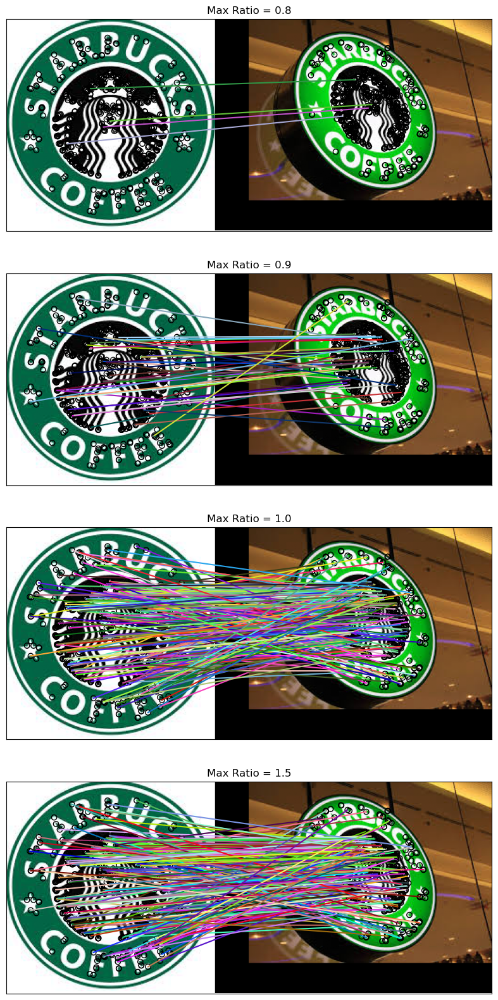

In [126]:
def get_ORB(image, n_keypoints=500):
    # Convert the image to grayscale
    gray_image = rgb2gray(image)

    # Detect ORB keypoints and descriptors
    descriptor_extractor = ORB(n_keypoints=n_keypoints)
    descriptor_extractor.detect_and_extract(gray_image)

    # Return keypoints and descriptors
    return descriptor_extractor.keypoints, descriptor_extractor.descriptors

# Load the model and scene images
starbucks_im = io.imread("images/starbucks.jpg")
starbucks4_im = io.imread("images/starbucks4.jpg")

# Get ORB keypoints and descriptors for both images
keypoints1, descriptors1 = get_ORB(starbucks_im)
keypoints2, descriptors2 = get_ORB(starbucks4_im)

# Define the maximum ratio for the nearest neighbor distance ratio test
max_ratio_values = [0.8, 0.9, 1.0, 1.5]

# Plot correspondences for different max_ratio values
fig, axs = plt.subplots(len(max_ratio_values),1, figsize=(20, 20), sharex=True, sharey=True)

# Loop through different max_ratio values
for i, max_ratio in enumerate(max_ratio_values):
    # Match descriptors between the model and scene images
    matches = match_descriptors(descriptors1, descriptors2, cross_check=True, max_ratio=max_ratio)

    # Plot matches
    plot_matches(axs[i], starbucks_im, starbucks4_im, keypoints1, keypoints2, matches)
    axs[i].set_title(f'Max Ratio = {max_ratio}')
    axs[i].set_xticks([])
    axs[i].set_yticks([])

plt.show()

Repeate the experiment comparing the `starbucks.jpg` image as a model, and showing its matches to all Starbucks images, sorting them based on their similarity to the model. Comment when does the algorithm work better.

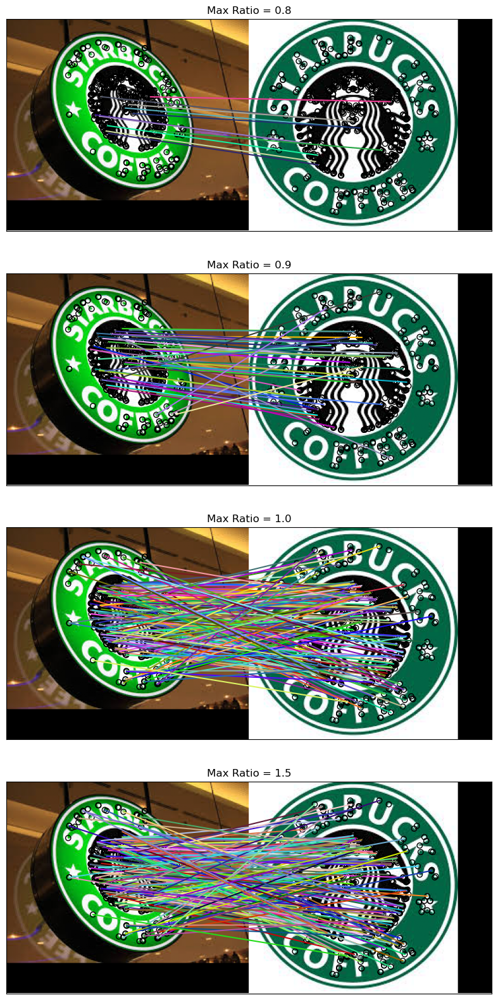

In [127]:
# Get ORB keypoints and descriptors for both images
keypoints1, descriptors1 = get_ORB(starbucks4_im)
keypoints2, descriptors2 = get_ORB(starbucks_im)

# Define the maximum ratio for the nearest neighbor distance ratio test
max_ratio_values = [0.8, 0.9, 1.0, 1.5]

# Plot correspondences for different max_ratio values
fig, axs = plt.subplots(len(max_ratio_values),1, figsize=(20, 20), sharex=True, sharey=True)

# Loop through different max_ratio values
for i, max_ratio in enumerate(max_ratio_values):
    # Match descriptors between the model and scene images
    matches = match_descriptors(descriptors1, descriptors2, cross_check=True, max_ratio=max_ratio)

    # Plot matches
    plot_matches(axs[i], starbucks4_im, starbucks_im, keypoints1, keypoints2, matches)
    axs[i].set_title(f'Max Ratio = {max_ratio}')
    axs[i].set_xticks([])
    axs[i].set_yticks([])

plt.show()

**3.3 (5 points)** Repeat the experiment:
- Changing the orientation of the model image by rotating it and comparing it with its original version. Help: you can use the rotate() function from skimage.transform
- Change the scale and orientation of the scene image and compare it with the model image.

**Help:** To do so, you can use the function given below as example:

```
import transform as tf
rotationdegrees = 180
img_rotated = tf.rotate(image2transform, rotationdegrees)
```

or

```
tform = tf.AffineTransform(scale=(1.2, 1.2), translation=(0, -100), rotation=0.5)
img_transformed = tf.warp(image2transform, tform)
```

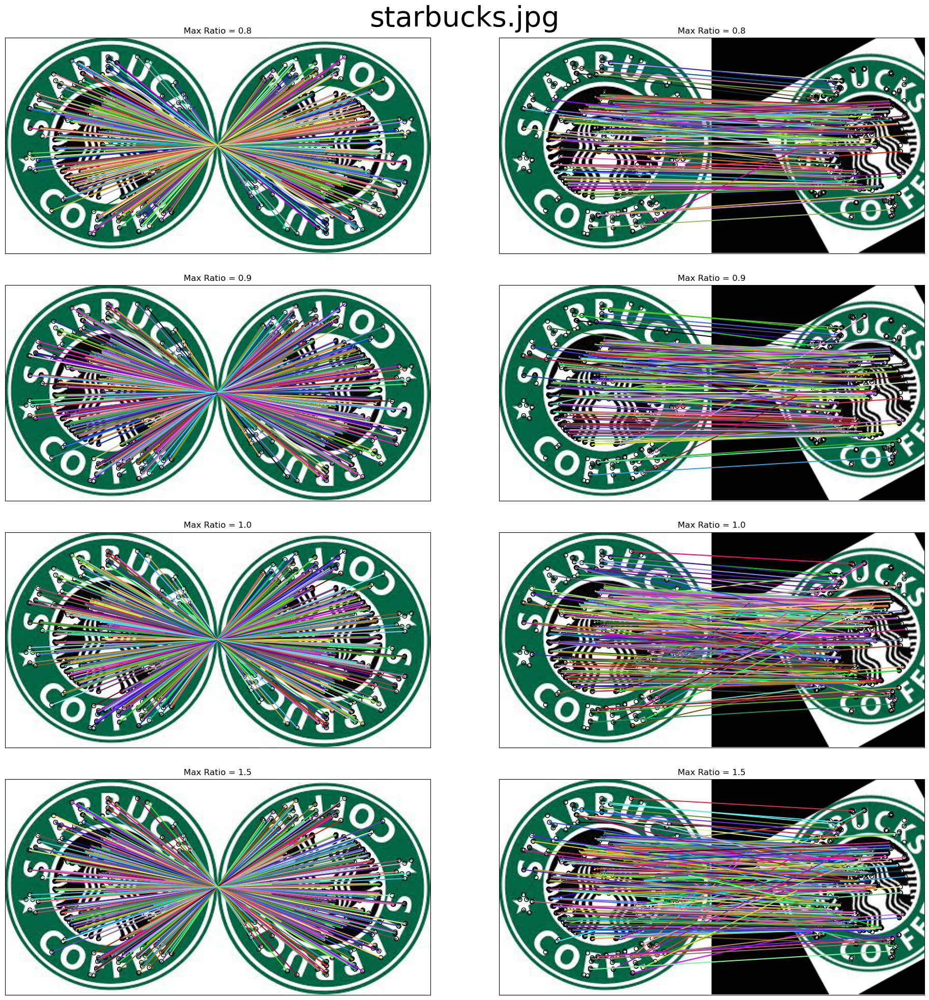

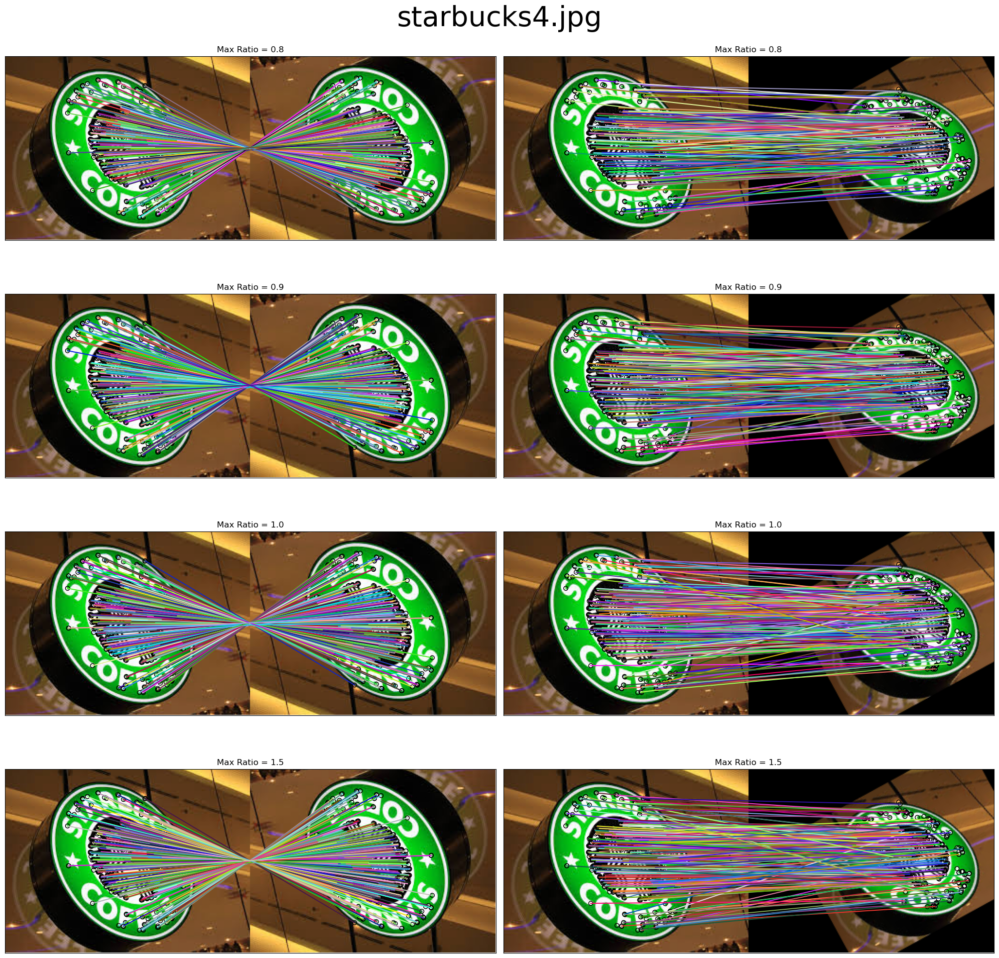

In [128]:
# Your solution here
def rotateTransformImageFeatureDetector(im, title):
    rotate_im = rotate(im, 180)
    tform = AffineTransform(scale=(1.2, 1.2), rotation=0.5, translation=(0, -100))
    transformed_im = warp(im, tform)

    # Get ORB keypoints and descriptors for both images
    keypoints1, descriptors1 = get_ORB(im)
    keypoints2, descriptors2 = get_ORB(rotate_im)
    keypoints3, descriptors3 = get_ORB(transformed_im)

    # Define the maximum ratio for the nearest neighbor distance ratio test
    max_ratio_values = [0.8, 0.9, 1.0, 1.5]

    # Plot correspondences for different max_ratio values
    fig, axs = plt.subplots(len(max_ratio_values),2, figsize=(20, 20), sharex=True, sharey=True)

    # Loop through different max_ratio values
    for i, max_ratio in enumerate(max_ratio_values):
        # Match descriptors between the model and scene images
        matches_rotate = match_descriptors(descriptors1, descriptors2, cross_check=True, max_ratio=max_ratio)
        matches_transformed = match_descriptors(descriptors1, descriptors3, cross_check=True, max_ratio=max_ratio)

        # Plot matches of rotated image
        plot_matches(axs[i][0], im, rotate_im, keypoints1, keypoints2, matches_rotate)
        axs[i][0].set_title(f'Max Ratio = {max_ratio}')
        axs[i][0].set_xticks([])
        axs[i][0].set_yticks([])

        # Plot matches of transformed image
        plot_matches(axs[i][1], im, transformed_im, keypoints1, keypoints3, matches_transformed)
        axs[i][1].set_title(f'Max Ratio = {max_ratio}')
        axs[i][1].set_xticks([])
        axs[i][1].set_yticks([])

    # Add a general title of subplots
    plt.suptitle(title, fontsize=40)
    plt.tight_layout(h_pad=3)
    plt.show()

rotateTransformImageFeatureDetector(starbucks_im, "starbucks.jpg")
rotateTransformImageFeatureDetector(starbucks4_im, "starbucks4.jpg")


**(Optional)** Repeat the experiment (3.1 to 3.3) with a new group of images. You could use Coca-Cola advertisements or from another famous brand, easily to find on internet.


In [ ]:
# Your solution here

**3.4 (5 points)** Analysis of the applied techniques and results

- What are the advantages of the ORB object detection with respect to the HOG and template object detector?

- What would happen if you analyse an image that does not contain the Starbucks logo?

- Could you think of ways of defining a quality measure for the correspondance between two images? (no need of implementing it)

In [ ]:
# Your solution here

# 4. SIFT

**4.1 (5 points)** Now use SIFT to the same problem statement as 3.2 exercise, make sure to show the results with all starbucks images provided. For now, you can use the default parameters of SIFT.
* Compare the results and the running time of both algortihms.
* Which one works best on this case?

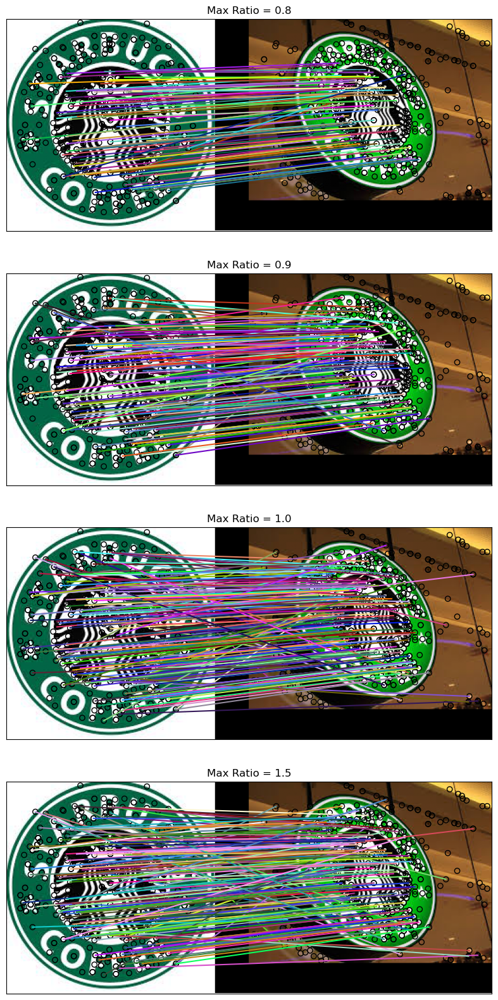

In [129]:
"""
Comparing the time using the %%time magic command in the whole cell, the SIFT algorithm is slower than the ORB algorithm.
The SIFT algorithm takes 1.1 seconds while the ORB algorithm takes ~840 ms.
This is correct becasue ORB uses Features from Accelerated Segment Test (FAST) keypoints and BRIEF descriptors, which are faster than SIFT keypoints and descriptors.

In this case with the same max_ratio values, SIFT algorithm performs better than the ORB algorithm. In the first image we can see that SIFT matches more keypoints than ORB.
"""


def get_SIFT(image):
    # Convert the image to grayscale
    gray_image = rgb2gray(image)

    # Detect SIFT keypoints and descriptors
    descriptor_extractor = SIFT()
    descriptor_extractor.detect_and_extract(gray_image)

    # Return keypoints and descriptors
    return descriptor_extractor.keypoints, descriptor_extractor.descriptors


# Load the model and scene images
starbucks_im = io.imread("images/starbucks.jpg")
starbucks4_im = io.imread("images/starbucks4.jpg")

# Get SIFT keypoints and descriptors for both images
keypoints1, descriptors1 = get_SIFT(starbucks_im)
keypoints2, descriptors2 = get_SIFT(starbucks4_im)

# Define the maximum ratio for the nearest neighbor distance ratio test
max_ratio_values = [0.8, 0.9, 1.0, 1.5]

# Plot correspondences for different max_ratio values
fig, axs = plt.subplots(len(max_ratio_values), 1,
                        figsize=(20, 20), sharex=True, sharey=True)

# Loop through different max_ratio values
for i, max_ratio in enumerate(max_ratio_values):
    # Match descriptors between the model and scene images
    matches = match_descriptors(
        descriptors1, descriptors2, cross_check=True, max_ratio=max_ratio)

    # Plot matches
    plot_matches(axs[i], starbucks_im, starbucks4_im,
                 keypoints1, keypoints2, matches)
    axs[i].set_title(f'Max Ratio = {max_ratio}')
    axs[i].set_xticks([])
    axs[i].set_yticks([])

plt.show()

**4.2 (10 points)** Analyze the different SIFT parameters. Try and show the results for at least 3 different combination of parameters for starbucks4.jpg image against starbucks model image.

* What are their effect?
* How do they compare to ORB parameters? 
* Which algorithm is more suitable for images with rotation? And for images that have been rescaled, which one is more effective?
* When it comes to changes in image intensity, which algorithm performs better, ORB or SIFT?

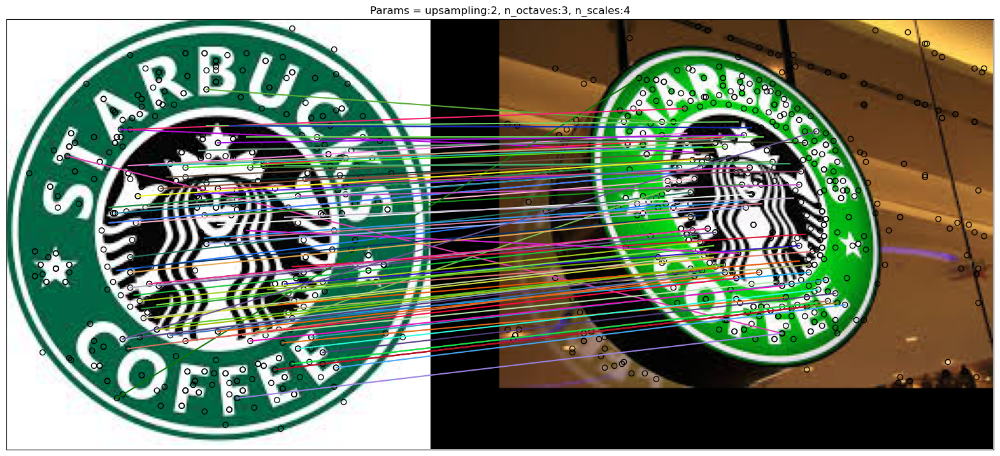

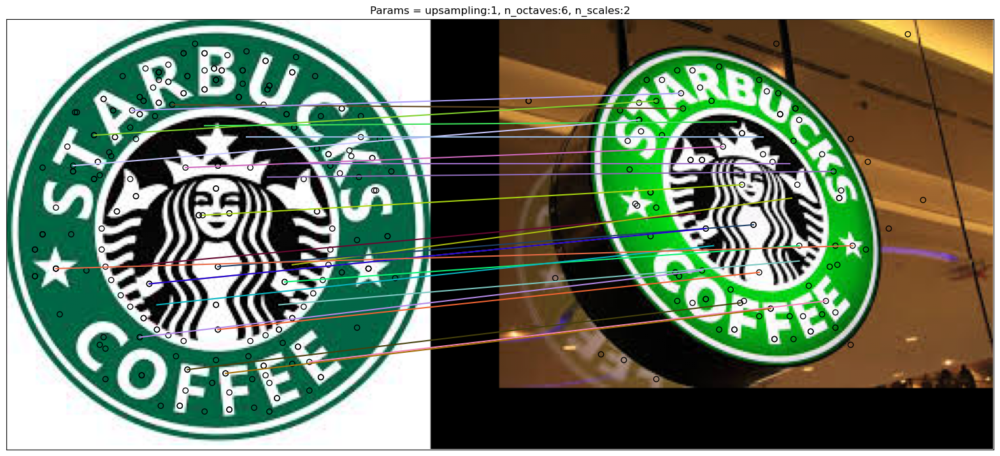

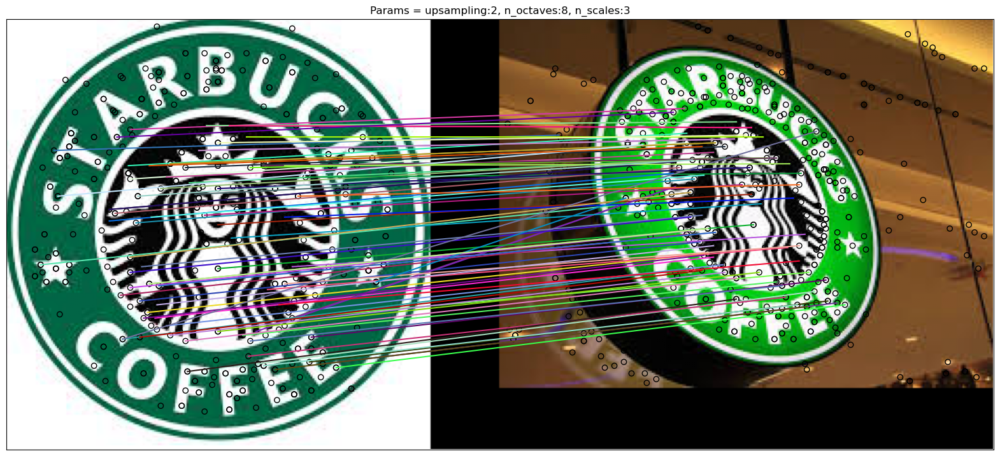

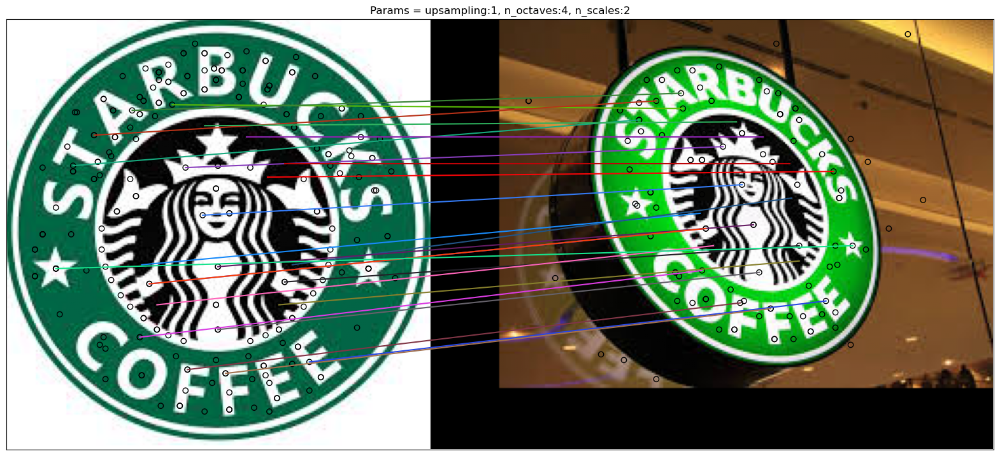

In [249]:
"""
Q1:
SIFT params:
upsampling: It aims to scale up the image by a given factor prior to the feature detection step. This is useful when the image is too small to detect features.
n_octaves: Maximum number of octaves. With every octave, the image sizes is halved and the sigma doubled.
n_scales: Number of scales per octave.
signa_min: Blur level of the seed image.
sigma_in: The assumed blur level of the input image.
c_dog: Threshold for the difference of Gaussian (DoG) response.
c_edge: Threshold to discard extrema that lie in edges.
n_bins: Number of bins for the orientation histogram.
lambda_ori: Constant to compute the orientation histogram.
c_max: Threshold at wich a secondary peak in the orientation histogram is considered to indicate a feature.
lambda_descr: Constant to normalize the descriptor.
n_hist: Number of bins for the descriptor histogram.
n_ori: Number of bins for the orientation histogram.

Q2: SIFT algorithm have more params than ORB. Both algorithms allows to control the number of keypoints detected, adjust the sensitivity to corners versus edges, and manage the scale at which features are identified.
However, SIFT tends to offer more parameters for fine-tuning, especially in terms of scale space representation and orientation assignment, making it versatile but computationally more demanding.
On the other hand, ORB is designed for efficiency, providing a faster alternative with fewer parameters, making it suitable for real-time applications where speed is crucial.

Q3: For images with rotation, SIFT is more suitable as it explicitly handles orientation during feature detection.
Both SIFT and ORB can handle rescaled images, but SIFT's inherent scale invariance makes it particularly effective in such scenarios.
If computational efficiency is crucial, ORB might be preferred for real-time applications. However, for robustness to rotation and scale changes, SIFT is a better choice.

Q4: For changes in image intensity, ORB (Oriented FAST and Rotated BRIEF) tends to perform better than SIFT (Scale-Invariant Feature Transform).
ORB is designed to be more robust to variations in image intensity and is generally faster, making it suitable for scenarios where lighting conditions may vary. SIFT, while robust to scale and rotation, may be more sensitive to changes in intensity.
"""
def get_SIFT_with_params(image, upsampling, n_octaves, n_scales):
    # Convert the image to grayscale if rgb
    gray_image = image
    if len(image.shape) > 2:
        gray_image = rgb2gray(image)
    # Detect SIFT keypoints and descriptors
    descriptor_extractor = SIFT(upsampling=upsampling, n_octaves=n_octaves, n_scales=n_scales)
    descriptor_extractor.detect_and_extract(gray_image)
    # Return keypoints and descriptors
    return descriptor_extractor.keypoints, descriptor_extractor.descriptors

def show_SIFT_with_params(image, image2, upsampling, n_octaves, n_scales, max_ratio=0.8):
    # Get SIFT keypoints and descriptors for both images
    keypoints1, descriptors1 = get_SIFT_with_params(image, upsampling, n_octaves, n_scales)
    keypoints2, descriptors2 = get_SIFT_with_params(image2, upsampling, n_octaves, n_scales)

    # Plot correspondences for different max_ratio values
    fig, axs = plt.subplots(1, 1, figsize=(20, 20), sharex=True, sharey=True)

    # Match descriptors between the model and scene images
    matches = match_descriptors(descriptors1, descriptors2, cross_check=True, max_ratio=max_ratio)
    # Plot matches
    plot_matches(axs, image, image2, keypoints1, keypoints2, matches)
    axs.set_title(f'Params = upsampling:{upsampling}, n_octaves:{n_octaves}, n_scales:{n_scales}')
    axs.set_xticks([])
    axs.set_yticks([])

    plt.show()

# Demo with different params
show_SIFT_with_params(starbucks_im, starbucks4_im, 2, 3, 4)
show_SIFT_with_params(starbucks_im, starbucks4_im, 1, 6, 2)
show_SIFT_with_params(starbucks_im, starbucks4_im, 2, 8, 3)
show_SIFT_with_params(starbucks_im, starbucks4_im, 1, 4, 2)

**4.3 (10 points)** Can we build an image classifier using the SIFT algorithm? Start by uploading the images from the folder `matches_SIFT`, then use the SIFT algorithm to find the most similar pairs (use the following parameters for this: max_ratio=0.8, upsampling=2, n_octaves=8, n_scales=3). To compare all the images, we'll need to establish a metric. We suggest to use the number of matches between images.

Show your results (SIFT result image matches and print the similarity only for the most similar image for each of the 6 images provided). Rescale the images to see the matches between images.

Answer the following: 
* Is the algorithm failing to find accurate matches (similar images) for some cases? If so, why do you think this is happening? You can assume that a good results is that eiffel tower images match between them and so on. 

Here is an example of the expected results for ciudad_ciencias_1.jpg (you also have to print the similarity metric result): 

<img src="images/example_city_of_arts.png" width="400" height="300">

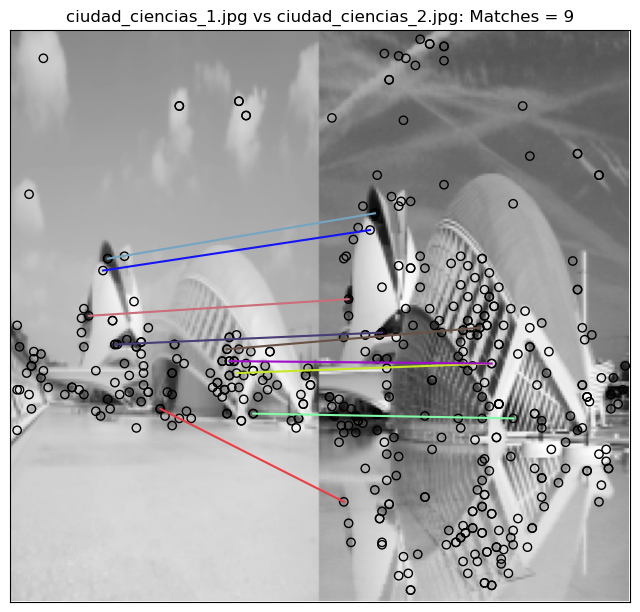

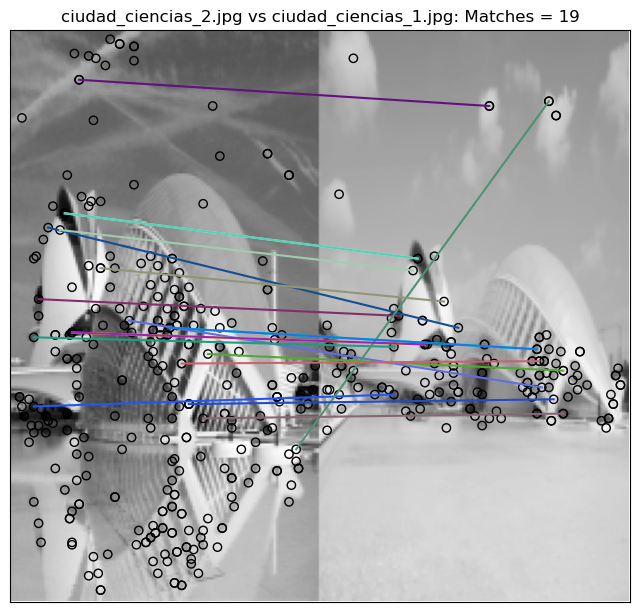

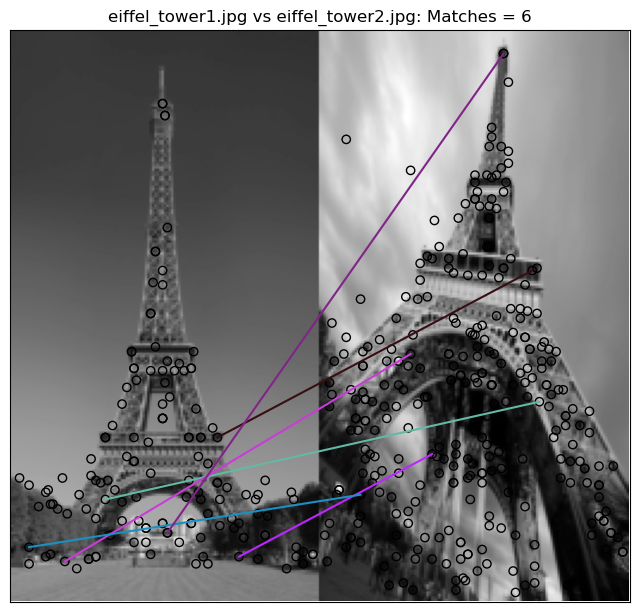

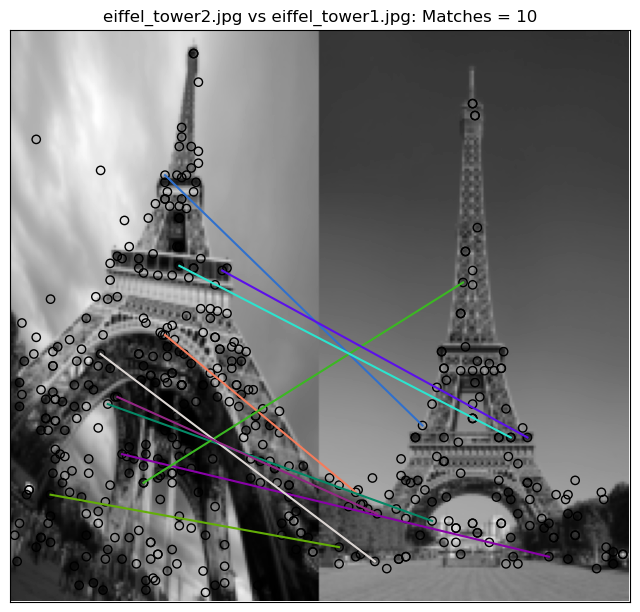

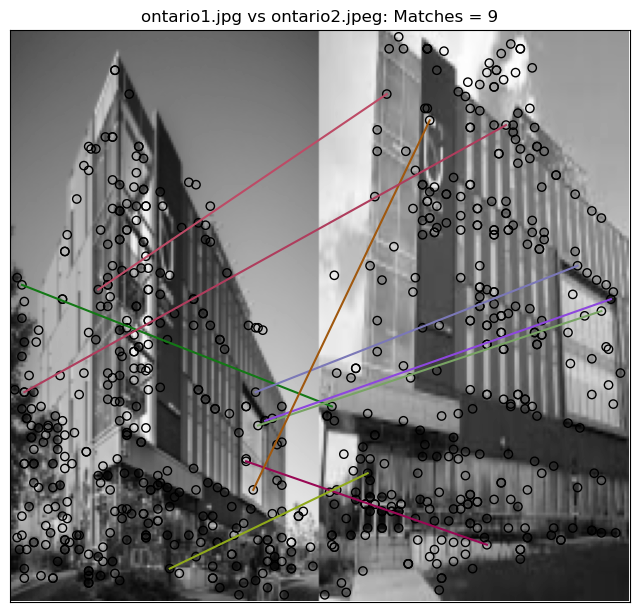

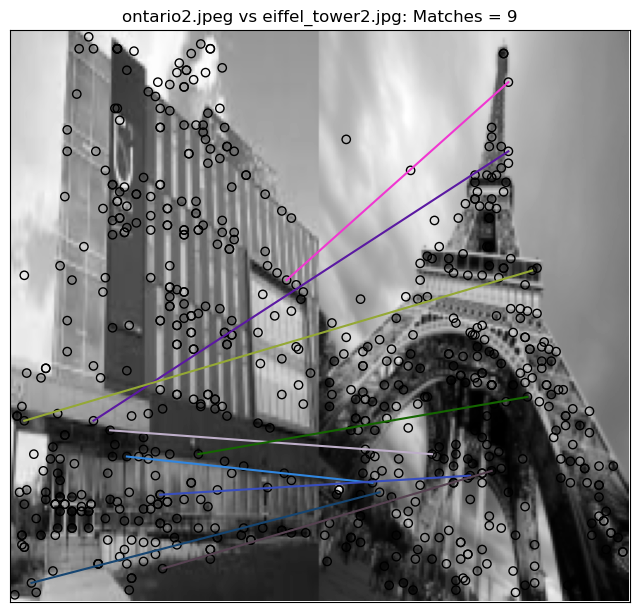

In [252]:
image_collection = io.ImageCollection('images/matches_SIFT/*')

best_matches = defaultdict()


# Resize and preprocess all images to the smallest size
processed_images = [resize(rgb2gray(image), (240, 130))
                    for image in image_collection]

for i in range(len(image_collection)):
    current_image = processed_images[i]
    keypoints1, descriptors1 = get_SIFT_with_params(
        current_image,  upsampling=2, n_octaves=8, n_scales=3)
    min_matches = float('-inf')
    for j in range(len(image_collection)):
        if i != j:
            image2 = processed_images[j]
            keypoints2, descriptors2 = get_SIFT_with_params(
                image2, upsampling=2, n_octaves=8, n_scales=3)
            matches = match_descriptors(
                descriptors1, descriptors2, max_ratio=0.8, cross_check=True)
            if len(matches) > min_matches:
                min_matches = len(matches)
                best_matches[i] = (current_image, image2,
                                   keypoints1, keypoints2, matches, j)

for i in range(len(best_matches)):
    fig, axs = plt.subplots(1, 1, figsize=(8, 8))
    image1, image2, keypoints1, keypoints2, matches, index = best_matches[i]
    plot_matches(axs, image1, image2, keypoints1, keypoints2, matches)
    filename1 = image_collection.files[i].split('/')[-1]
    filename2 = image_collection.files[index].split('/')[-1]
    axs.set_title(f'{filename1} vs {filename2}: Matches = {len(matches)}')
    axs.set_xticks([])
    axs.set_yticks([])

    plt.show()

### Appendix

In [34]:
# In case the plot_matches() function gives you some problems, you can use the following one:

from skimage.util import img_as_float
import numpy as np

def plot_matches_aux(ax, image1, image2, keypoints1, keypoints2, matches,
                 keypoints_color='k', matches_color=None, only_matches=False):
    """Plot matched features.
    Parameters
    ----------
    ax : matplotlib.axes.Axes
        Matches and image are drawn in this ax.
    image1 : (N, M [, 3]) array
        First grayscale or color image.
    image2 : (N, M [, 3]) array
        Second grayscale or color image.
    keypoints1 : (K1, 2) array
        First keypoint coordinates as ``(row, col)``.
    keypoints2 : (K2, 2) array
        Second keypoint coordinates as ``(row, col)``.
    matches : (Q, 2) array
        Indices of corresponding matches in first and second set of
        descriptors, where ``matches[:, 0]`` denote the indices in the first
        and ``matches[:, 1]`` the indices in the second set of descriptors.
    keypoints_color : matplotlib color, optional
        Color for keypoint locations.
    matches_color : matplotlib color, optional
        Color for lines which connect keypoint matches. By default the
        color is chosen randomly.
    only_matches : bool, optional
        Whether to only plot matches and not plot the keypoint locations.
    """

    image1 = img_as_float(image1)
    image2 = img_as_float(image2)

    new_shape1 = list(image1.shape)
    new_shape2 = list(image2.shape)

    if image1.shape[0] < image2.shape[0]:
        new_shape1[0] = image2.shape[0]
    elif image1.shape[0] > image2.shape[0]:
        new_shape2[0] = image1.shape[0]

    if image1.shape[1] < image2.shape[1]:
        new_shape1[1] = image2.shape[1]
    elif image1.shape[1] > image2.shape[1]:
        new_shape2[1] = image1.shape[1]

    if new_shape1 != image1.shape:
        new_image1 = np.zeros(new_shape1, dtype=image1.dtype)
        new_image1[:image1.shape[0], :image1.shape[1]] = image1
        image1 = new_image1

    if new_shape2 != image2.shape:
        new_image2 = np.zeros(new_shape2, dtype=image2.dtype)
        new_image2[:image2.shape[0], :image2.shape[1]] = image2
        image2 = new_image2

    image = np.concatenate([image1, image2], axis=1)

    offset = image1.shape

    if not only_matches:
        ax.scatter(keypoints1[:, 1], keypoints1[:, 0],
                   facecolors='none', edgecolors=keypoints_color)
        ax.scatter(keypoints2[:, 1] + offset[1], keypoints2[:, 0],
                   facecolors='none', edgecolors=keypoints_color)

    ax.imshow(image, interpolation='nearest', cmap='gray')
    ax.axis((0, 2 * offset[1], offset[0], 0))

    for i in range(matches.shape[0]):
        idx1 = matches[i, 0]
        idx2 = matches[i, 1]

        if matches_color is None:
            color = np.random.rand(3)
        else:
            color = matches_color

        ax.plot((keypoints1[idx1, 1], keypoints2[idx2, 1] + offset[1]),
                (keypoints1[idx1, 0], keypoints2[idx2, 0]),
                '-', color=color)